In [31]:
import torch 

from torch.utils.data import DataLoader
import numpy as np 
import matplotlib.pyplot as plt
import os 
from tqdm import tqdm
from typing import List, Dict, Tuple
import einops
from vit_prisma.utils.data_utils.imagenet_utils import setup_imagenet_paths
from vit_prisma.dataloaders.imagenet_dataset import ImageNetValidationDataset
from vit_prisma.transforms.open_clip_transforms import get_clip_val_transforms
from vit_prisma.models.base_vit import HookedViT
from vit_prisma.sae.sae import SparseAutoencoder
from vit_prisma.sae.sae_utils import download_sae_from_huggingface
from vit_prisma.sae.evals.evals import EvalConfig
from transformers import CLIPModel 
from transformers import CLIPProcessor
from typing import List 
import urllib.request
from fancy_einsum import einsum
import torchvision

torch.set_grad_enabled(False)

Helper functions

In [32]:

def get_imagenet_val_dataset(dataset_path):

    data_transforms = get_clip_val_transforms()
    imagenet_paths = setup_imagenet_paths(dataset_path)
    return ImageNetValidationDataset(imagenet_paths['val'], 
                                    imagenet_paths['label_strings'], 
                                    imagenet_paths['val_labels'], 
                                    data_transforms, return_index=True
    )

def get_imagenet_val_dataset_visualize(dataset_path):
    imagenet_paths = setup_imagenet_paths(dataset_path)

    return ImageNetValidationDataset(imagenet_paths['val'], 
                                imagenet_paths['label_strings'], 
                                imagenet_paths['val_labels'],
                                torchvision.transforms.Compose([
    torchvision.transforms.Resize((224, 224)),
    torchvision.transforms.ToTensor(),]), return_index=True)

def get_clip_model(model_name='open-clip:laion/CLIP-ViT-B-32-DataComp.XL-s13B-b90K'):                
    model = HookedViT.from_pretrained(model_name, is_timm=False, is_clip=True, fold_ln=False, center_writing_weights=False) 
    return model

def load_sae(download_dir):
    repo_name = 'soniajoseph/updated-sae-weights'
    file_id = 'UPDATED-final_sae_group_wkcn_TinyCLIP-ViT-40M-32-Text-19M-LAION400M_blocks.9.hook_mlp_out_8192.pt'
    download_sae_from_huggingface(repo_name, file_id, download_dir)

    sae_path= os.path.join(download_dir, file_id)
    sae = SparseAutoencoder(EvalConfig()).load_from_pretrained_legacy_saelens_v2(sae_path)  #TODO may need option to modify cfg
    return sae 

class ClipTextStuff:

    def __init__(self, model_name, device="cuda"):

        self.device= device 

        self.clip_processor = CLIPProcessor.from_pretrained(model_name)



        full_clip_model = CLIPModel.from_pretrained(model_name)

        self.text_model = full_clip_model.text_model.to(device)
        self.text_projection = full_clip_model.text_projection.to(device)
        self.logit_scale = full_clip_model.logit_scale
        with urllib.request.urlopen("https://raw.githubusercontent.com/yossigandelsman/clip_text_span/main/text_descriptions/image_descriptions_general.txt") as response:
            self.labels = response.read().decode('utf-8').split('\n')

        ## adding some labels that I think are relevant to my stuff
        self.labels = self.labels + ["facial hair", "mustache", "man with mustache", "beard",
                                      "bike", "bicycle", "cycling",
                                        "bazaar", "grocery", "outdoor market"
                                        "old pictures", "black and white", "30s", "40s", "50s",
                                        "computer fan", "the machine fan", "electronics", "gpu", "cpu", "tech", "hardware", "Peripherals",
                                        "chess", "chess game", "orange jerseys"
                                        ]             
        self.labels_projected = self.get_text_embeds(self.labels)


        # for context here is how similarity is computed:
        # image_embeds = vision_outputs[1]
        # image_embeds = self.visual_projection(image_embeds)

        # text_embeds = text_outputs[1]
        # text_embeds = self.text_projection(text_embeds)

        # # normalized features
        # image_embeds = image_embeds / image_embeds.norm(p=2, dim=-1, keepdim=True)
        # text_embeds = text_embeds / text_embeds.norm(p=2, dim=-1, keepdim=True)

        # # cosine similarity as logits
        # logit_scale = self.logit_scale.exp()
        # logits_per_text = torch.matmul(text_embeds, image_embeds.t()) * logit_scale
        # logits_per_image = logits_per_text.t()

        pass

    def get_text_embeds(self, list_of_strings:List[str]):
        labels_input = self.clip_processor(text=list_of_strings, return_tensors='pt',  padding=True).input_ids
        labels_input = labels_input.to(self.device)

        labels_projections = self.text_projection(self.text_model(labels_input)[1])

        # normalize
        labels_projections = labels_projections/ labels_projections.norm(p=2, dim=-1, keepdim=True)

        return labels_projections

Setup stuff

In [48]:

output_folder = r"F:/ViT-Prisma_fork/data/textspans/output"
imagenet_dataset_path = r"F:/prisma_data/imagenet-object-localization-challenge"  
sae_download_dir =   r'F:/ViT-Prisma_fork/data/textspans/attempted_models/new'

model_name = "wkcn/TinyCLIP-ViT-40M-32-Text-19M-LAION400M"

sae = load_sae(sae_download_dir)
model = get_clip_model(model_name)

os.makedirs(output_folder, exist_ok=True)


hook_layer = 9
hook_point = f"blocks.{hook_layer}.hook_mlp_out"
#F:\ViT-Prisma_fork\data\vision_sae_checkpoints\comparisons\mlp\mlp_16
feature_ids = [2381, 6405, 5379, 6827, 3471, 1436, 264, 6999, 1554, 2498, 4285 ]
descriptions = ["mustache", "bike", "food market (CLS TOKEN!)", "black and white photo (CLS TOKEN!)",
                 "computer hardware (CLS TOKEN!)", "image boundaries", "The text 'in' and 'on'",
                 "Polysemantic? animals in trees and certain products in foreground with plain backgrounds",
                 "Chess?",
                 "Sport players? Orange jerseys?",
                 "Legs of sport players",
                 
                 ]
cls_token_or_not = [False, False, True, True, True, False, False, False, False, False,False]

assert len(feature_ids) == len(descriptions) == len(cls_token_or_not)

stop_at_layer = hook_layer+1 


dataset = get_imagenet_val_dataset(imagenet_dataset_path)
visualize_dataset = get_imagenet_val_dataset_visualize(imagenet_dataset_path)



n_ctx = 50 

device= "cuda"



model = model.to(device)
sae = sae.to(device)
clip_text_stuff = ClipTextStuff(model_name,device=device)

File downloaded successfully to: F:\ViT-Prisma_fork\data\textspans\attempted_models\new\UPDATED-final_sae_group_wkcn_TinyCLIP-ViT-40M-32-Text-19M-LAION400M_blocks.9.hook_mlp_out_8192.pt
File size: 33592403 bytes
n_tokens_per_buffer (millions): 0.032
Lower bound: n_contexts_per_buffer (millions): 0.00064
Total training steps: 15869
Total training images: 1300000
Total wandb updates: 158
Expansion factor: 16
n_tokens_per_feature_sampling_window (millions): 204.8
n_tokens_per_dead_feature_window (millions): 1024.0
Using Ghost Grads.
We will reset the sparsity calculation 15 times.
Number tokens in sparsity calculation window: 4.10e+06
Gradient clipping with max_norm=1.0
Using SAE initialization method: encoder_transpose_decoder
get_activation_fn received: activation_fn=relu, kwargs={}
n_tokens_per_buffer (millions): 0.0512
Lower bound: n_contexts_per_buffer (millions): 0.001024
Total training steps: 15869
Total training images: 1300000
Total wandb updates: 158
Expansion factor: 16
n_token

c:\ProgramData\Anaconda3\envs\vit-prisma\lib\site-packages\huggingface_hub\file_download.py:797: FutureWarning:

`resume_download` is deprecated and will be removed in version 1.0.0. Downloads always resume when possible. If you want to force a new download, use `force_download=True`.



Official model name wkcn/TinyCLIP-ViT-40M-32-Text-19M-LAION400M
Loaded pretrained model wkcn/TinyCLIP-ViT-40M-32-Text-19M-LAION400M into HookedTransformer


We need to gather high activating images. 

In [6]:

@torch.no_grad()
def compute_feature_activations(
    images: torch.Tensor,
    model: torch.nn.Module,
    sparse_autoencoder: torch.nn.Module,
    encoder_weights: torch.Tensor,
    encoder_biases: torch.Tensor,
    feature_ids: List[int],
    is_cls_list: List[bool],
    top_k: int = 10
) -> Dict[int, Tuple[torch.Tensor, torch.Tensor]]:
    """
    Compute the highest activating tokens for given features in a batch of images.
    
    Args:
        images: Input images
        model: The main model
        sparse_autoencoder: The sparse autoencoder
        encoder_weights: Encoder weights for selected features
        encoder_biases: Encoder biases for selected features
        feature_ids: List of feature IDs to analyze
        feature_categories: Categories of the features
        top_k: Number of top activations to return per feature

    Returns:
        Dictionary mapping feature IDs to tuples of (top_indices, top_values)
    """
    _, cache = model.run_with_cache(images, names_filter=[sparse_autoencoder.cfg.hook_point])
    
    layer_activations = cache[sparse_autoencoder.cfg.hook_point]
    batch_size, seq_len, _ = layer_activations.shape
    flattened_activations = einops.rearrange(layer_activations, "batch seq d_mlp -> (batch seq) d_mlp")
    
    sae_input = flattened_activations - sparse_autoencoder.b_dec
    feature_activations = einops.einsum(sae_input, encoder_weights, "... d_in, d_in n -> ... n") + encoder_biases
    feature_activations = torch.nn.functional.relu(feature_activations)
    
    reshaped_activations = einops.rearrange(feature_activations, "(batch seq) d_in -> batch seq d_in", batch=batch_size, seq=seq_len)
    cls_token_activations = reshaped_activations[:, 0, :]
    mean_image_activations = reshaped_activations.mean(1)

    top_activations = {}
    for i, (feature_id, is_cls) in enumerate(zip(feature_ids, is_cls_list)):
        if is_cls:
            top_values, top_indices = cls_token_activations[:, i].topk(top_k)
        else:
            top_values, top_indices = mean_image_activations[:, i].topk(top_k)
        top_activations[feature_id] = (top_indices, top_values)
    
    return top_activations

def find_top_activations(
    val_dataloader: torch.utils.data.DataLoader,
    model: torch.nn.Module,
    sparse_autoencoder: torch.nn.Module,
    interesting_features_indices: List[int],
    is_cls_list: List[bool],
    top_k: int = 16,
    max_samples= 50_000,
    batch_size = 54, 
) -> Dict[int, Tuple[torch.Tensor, torch.Tensor]]:
    """
    Find the top activations for interesting features across the validation dataset.

    Args:
        val_dataloader: Validation data loader
        model: The main model
        sparse_autoencoder: The sparse autoencoder
        interesting_features_indices: Indices of interesting features
        interesting_features_category: Categories of interesting features

    Returns:
        Dictionary mapping feature IDs to tuples of (top_values, top_indices)
    """
    device = next(model.parameters()).device
    top_activations = {i: (None, None) for i in interesting_features_indices}
    encoder_biases = sparse_autoencoder.b_enc[interesting_features_indices]
    encoder_weights = sparse_autoencoder.W_enc[:, interesting_features_indices]

    processed_samples = 0
    for batch_images, _, batch_indices in tqdm(val_dataloader, total=max_samples // batch_size):
        batch_images = batch_images.to(device)
        batch_indices = batch_indices.to(device)
        batch_size = batch_images.shape[0]

        batch_activations = compute_feature_activations(
            batch_images, model, sparse_autoencoder, encoder_weights, encoder_biases,
            interesting_features_indices, is_cls_list, top_k
        )

        for feature_id in interesting_features_indices:
            new_indices, new_values = batch_activations[feature_id]
            new_indices = batch_indices[new_indices]
            
            if top_activations[feature_id][0] is None:
                top_activations[feature_id] = (new_values, new_indices)
            else:
                combined_values = torch.cat((top_activations[feature_id][0], new_values))
                combined_indices = torch.cat((top_activations[feature_id][1], new_indices))
                _, top_k_indices = torch.topk(combined_values, top_k)
                top_activations[feature_id] = (combined_values[top_k_indices], combined_indices[top_k_indices])

        processed_samples += batch_size
        if processed_samples >= max_samples:
            break

    return {i: (values.detach().cpu(), indices.detach().cpu()) 
            for i, (values, indices) in top_activations.items()}

torch.no_grad()
def get_heatmap(
          image,
          model,
          sparse_autoencoder,
          feature_id,
          device,
): 
    image = image.to(device)
    _, cache = model.run_with_cache(image.unsqueeze(0))

    post_reshaped = einops.rearrange(cache[sparse_autoencoder.cfg.hook_point], "batch seq d_mlp -> (batch seq) d_mlp")
    # Compute activations (not from a fwd pass, but explicitly, by taking only the feature we want)
    # This code is copied from the first part of the 'forward' method of the AutoEncoder class
    sae_in =  post_reshaped - sparse_autoencoder.b_dec # Remove decoder bias as per Anthropic
    acts = einops.einsum(
            sae_in,
            sparse_autoencoder.W_enc[:, feature_id],
            "x d_in, d_in -> x",
        )
    return acts 
     
def image_patch_heatmap(activation_values,image_size=224, pixel_num=14):
    activation_values = activation_values.detach().cpu().numpy()
    activation_values = activation_values[1:]
    activation_values = activation_values.reshape(pixel_num, pixel_num)

    # Create a heatmap overlay
    heatmap = np.zeros((image_size, image_size))
    patch_size = image_size // pixel_num

    for i in range(pixel_num):
        for j in range(pixel_num):
            heatmap[i*patch_size:(i+1)*patch_size, j*patch_size:(j+1)*patch_size] = activation_values[i, j]

    return heatmap

    # Removing axes

def visualize_top_activating_images(model, sae, top_activations_per_feature, dataset, dataset_visualize, device, patch_size=32):
    for feature_ids in tqdm(top_activations_per_feature.keys(), total=len(top_activations_per_feature)):
        max_vals, max_inds = top_activations_per_feature[feature_ids]
        images = []
        model_images = []
        for bid in max_inds:

            image, _, image_ind = dataset_visualize[bid]

            assert image_ind.item() == bid
            images.append(image)

            model_image, _, _ = dataset[bid]
            model_images.append(model_image)
        
        grid_size = int(np.ceil(np.sqrt(len(images))))
        fig, axs = plt.subplots(int(np.ceil(len(images)/grid_size)), grid_size, figsize=(15, 15))
        name=  f"Feature: {feature_ids}"
        fig.suptitle(name)#, y=0.95)
        for ax in axs.flatten():
            ax.axis('off')
        complete_bid = []

        for i, (image_tensor, val, bid,model_img) in enumerate(zip(images, max_vals,max_inds,model_images )):
            if bid in complete_bid:
                continue 
            complete_bid.append(bid)


            row = i // grid_size
            col = i % grid_size
            heatmap = get_heatmap(model_img,model,sae, feature_ids,device )
            heatmap = image_patch_heatmap(heatmap, pixel_num=224//patch_size)

            display = image_tensor.numpy().transpose(1, 2, 0)


            axs[row, col].imshow(display)
            axs[row, col].imshow(heatmap, cmap='viridis', alpha=0.3)  # Overlaying the heatmap
            axs[row, col].set_title(f"{val.item():0.03f}")  
            axs[row, col].axis('off')  

        plt.tight_layout()

        plt.show()
        plt.close()

In [7]:
top_k = 64
batch_size = 64
val_dataloader = DataLoader(dataset, batch_size=batch_size, shuffle=False, num_workers=4, drop_last=True)
top_activations_per_feature = find_top_activations(
    val_dataloader, model, sae,
    feature_ids, cls_token_or_not, batch_size=batch_size, top_k=top_k
)

100%|██████████| 781/781 [01:42<00:00,  7.61it/s]


  0%|          | 0/11 [00:00<?, ?it/s]

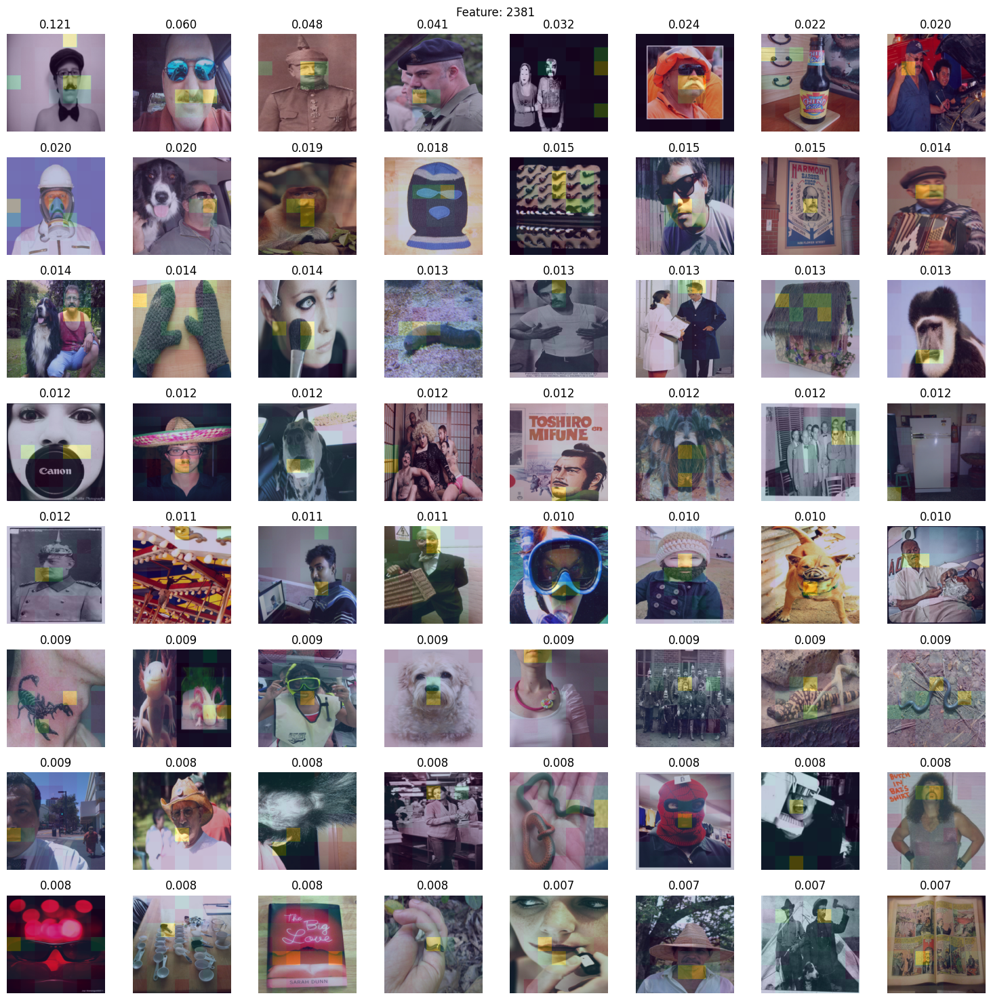

  9%|▉         | 1/11 [00:07<01:18,  7.83s/it]

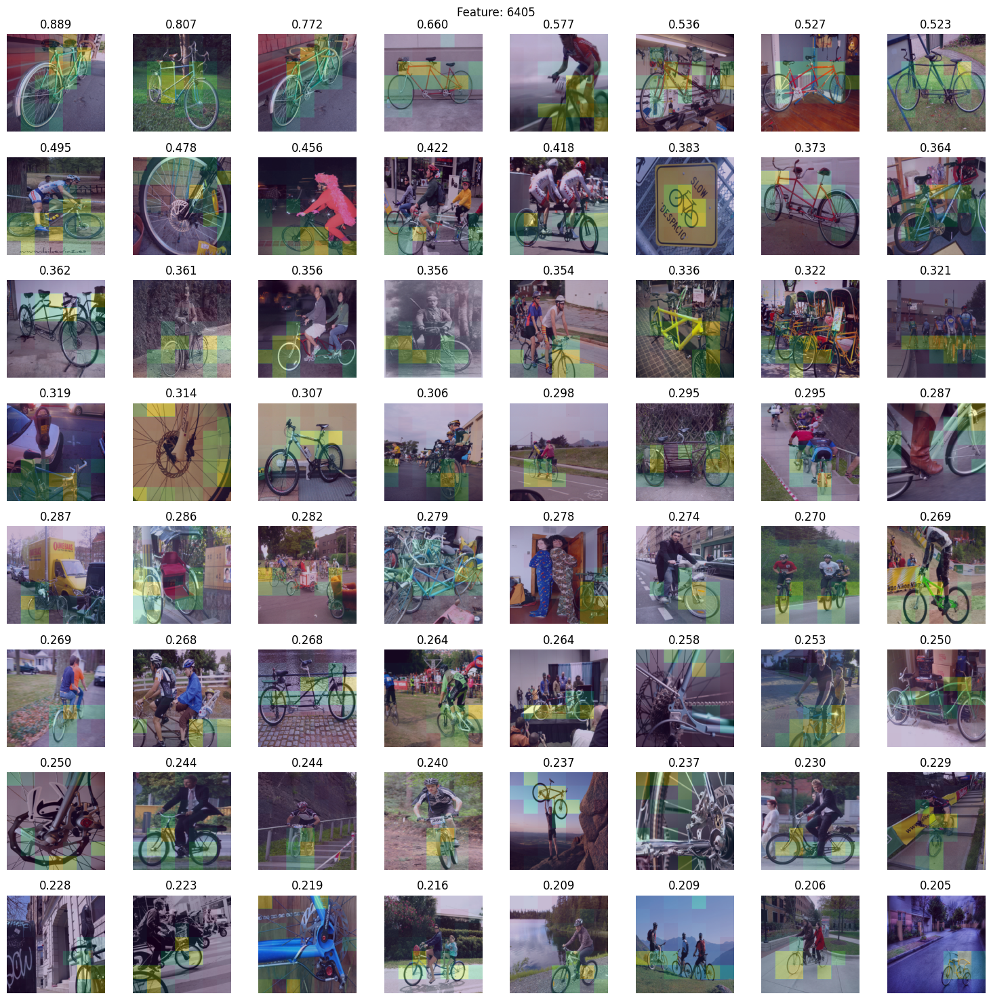

 18%|█▊        | 2/11 [00:15<01:10,  7.88s/it]

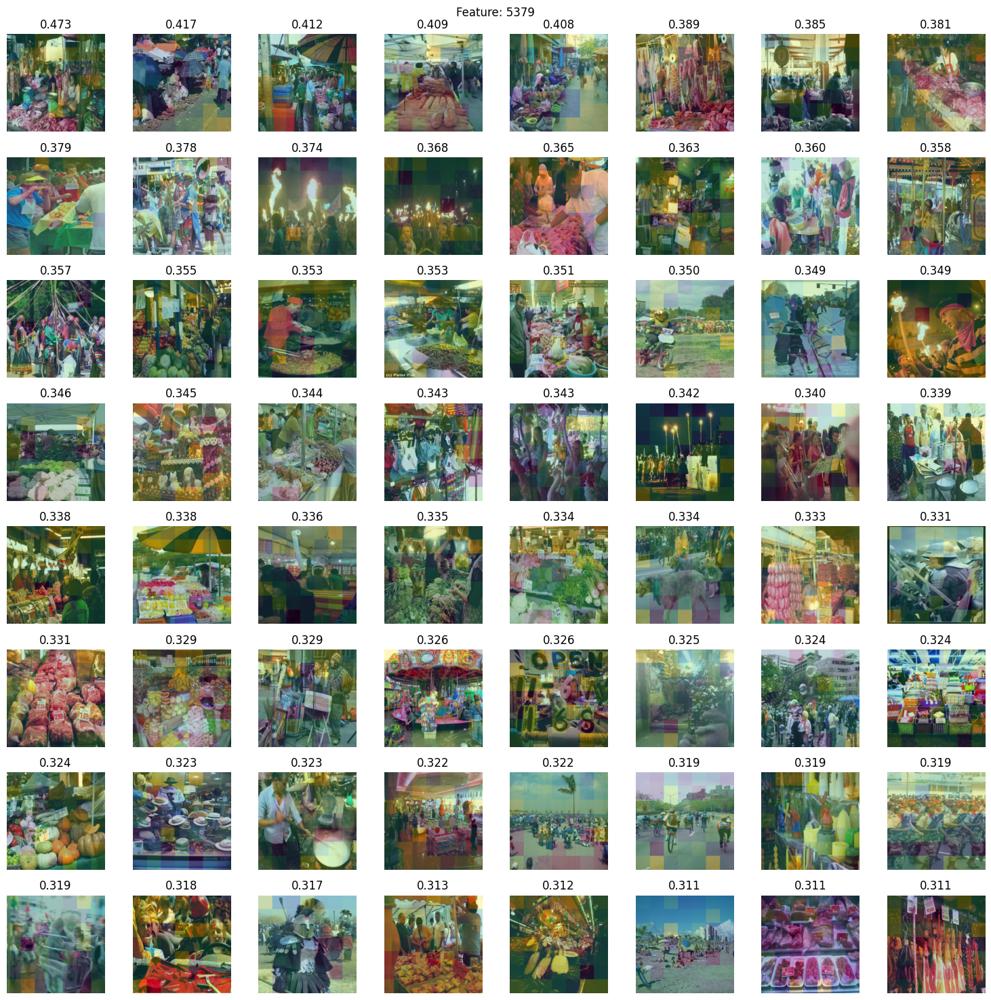

 27%|██▋       | 3/11 [00:23<01:03,  7.92s/it]

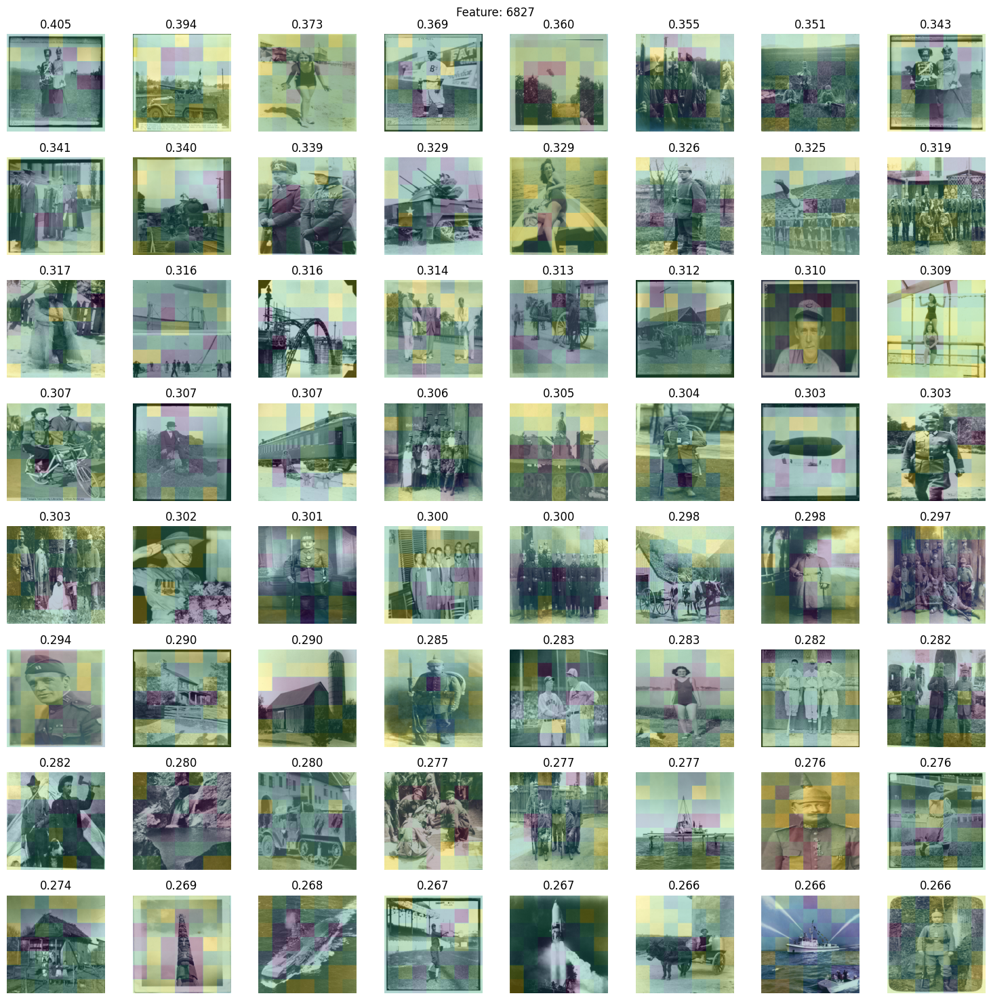

 36%|███▋      | 4/11 [00:31<00:56,  8.04s/it]

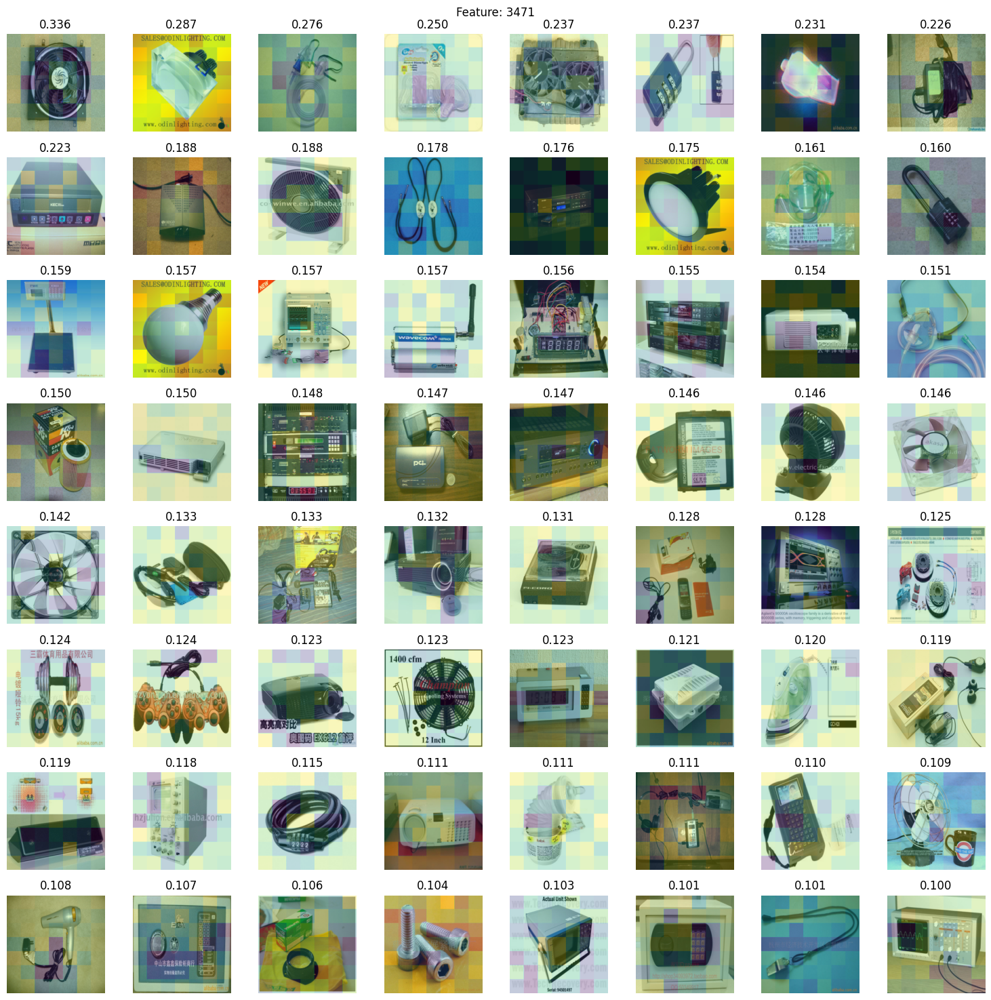

 45%|████▌     | 5/11 [00:39<00:47,  7.96s/it]

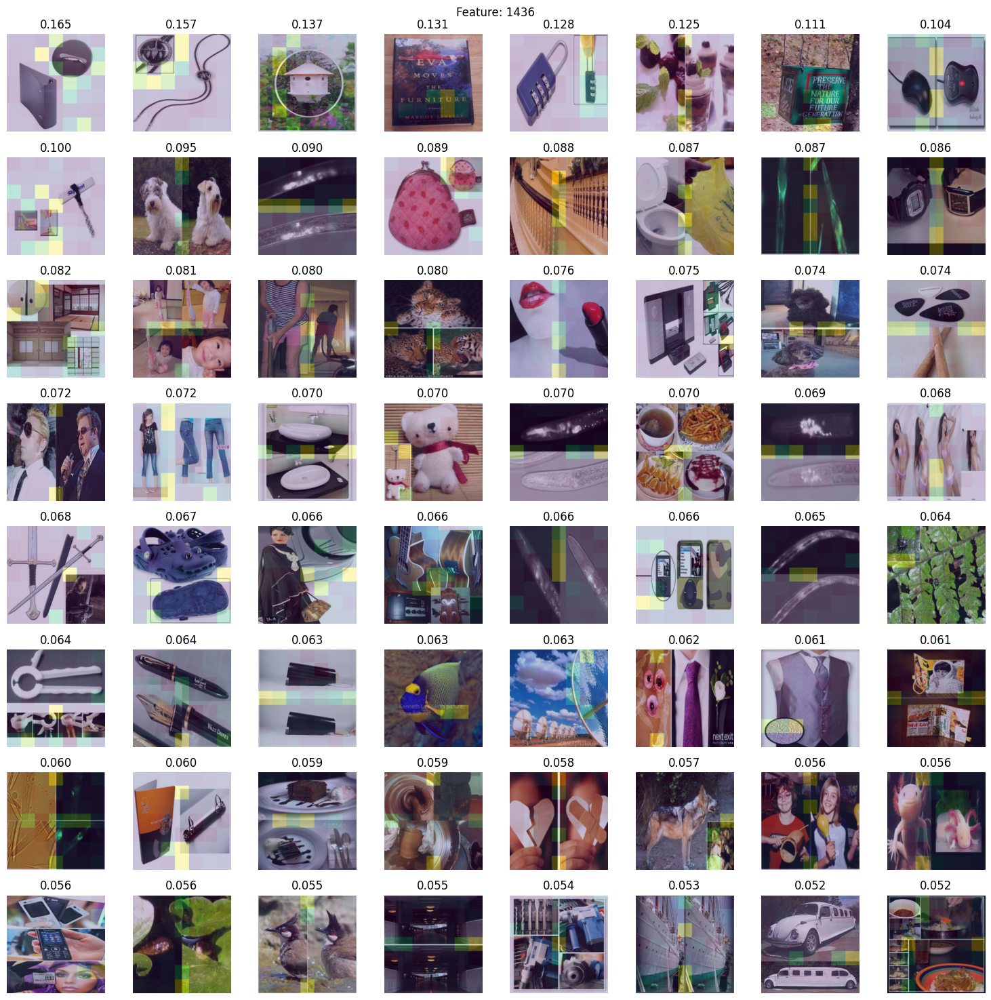

 55%|█████▍    | 6/11 [00:47<00:39,  7.84s/it]

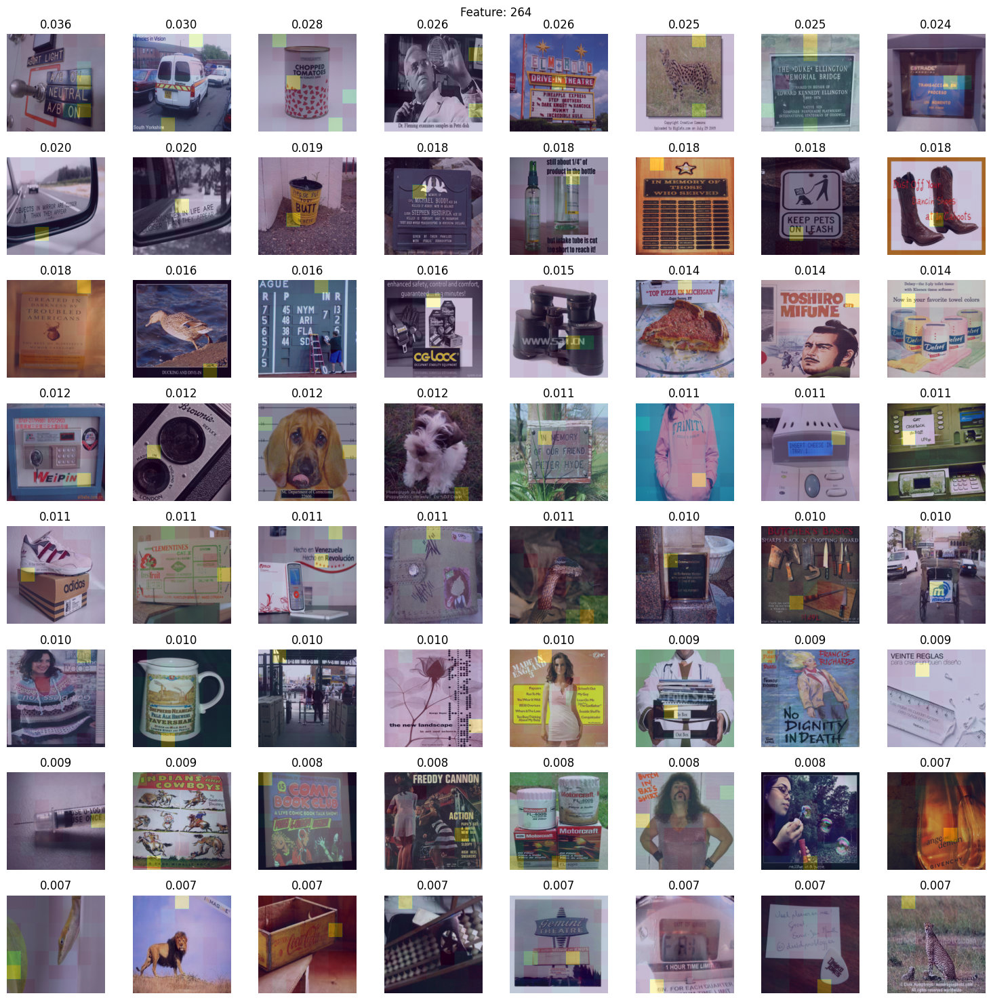

 64%|██████▎   | 7/11 [00:55<00:32,  8.06s/it]

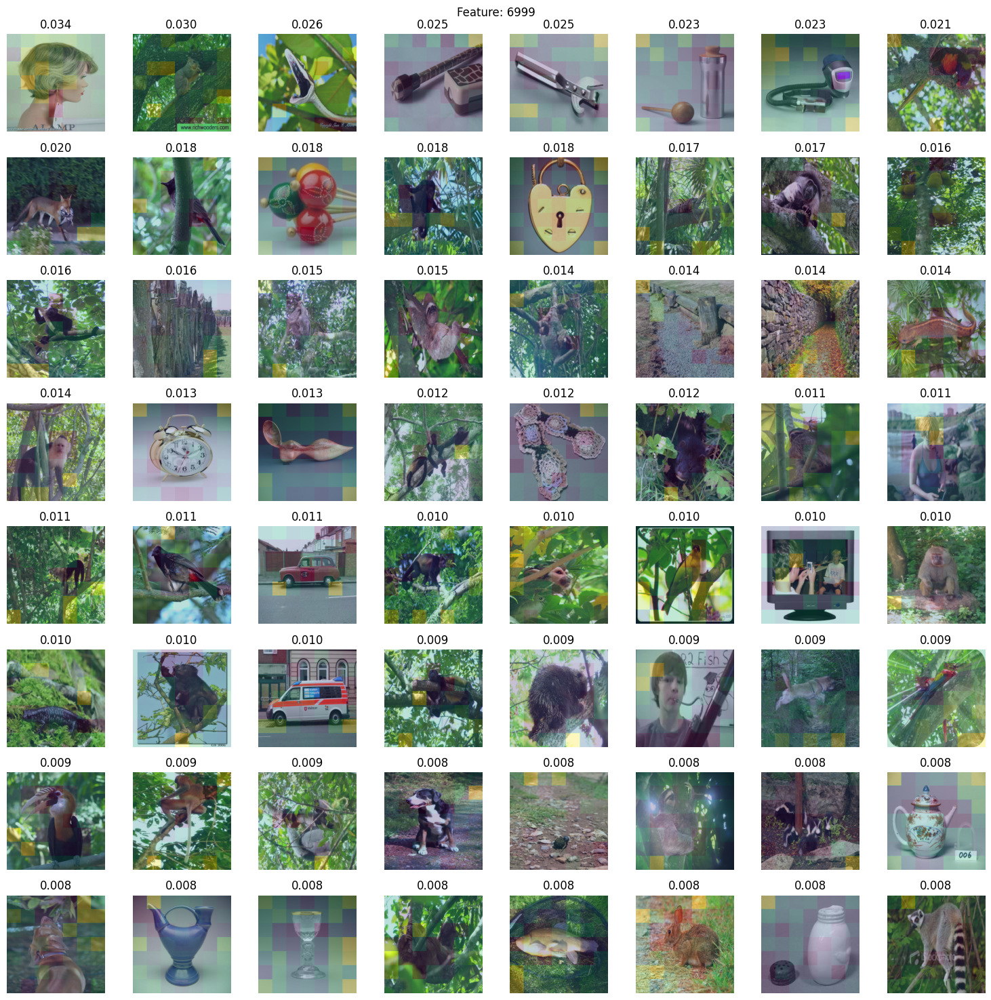

 73%|███████▎  | 8/11 [01:03<00:23,  7.92s/it]

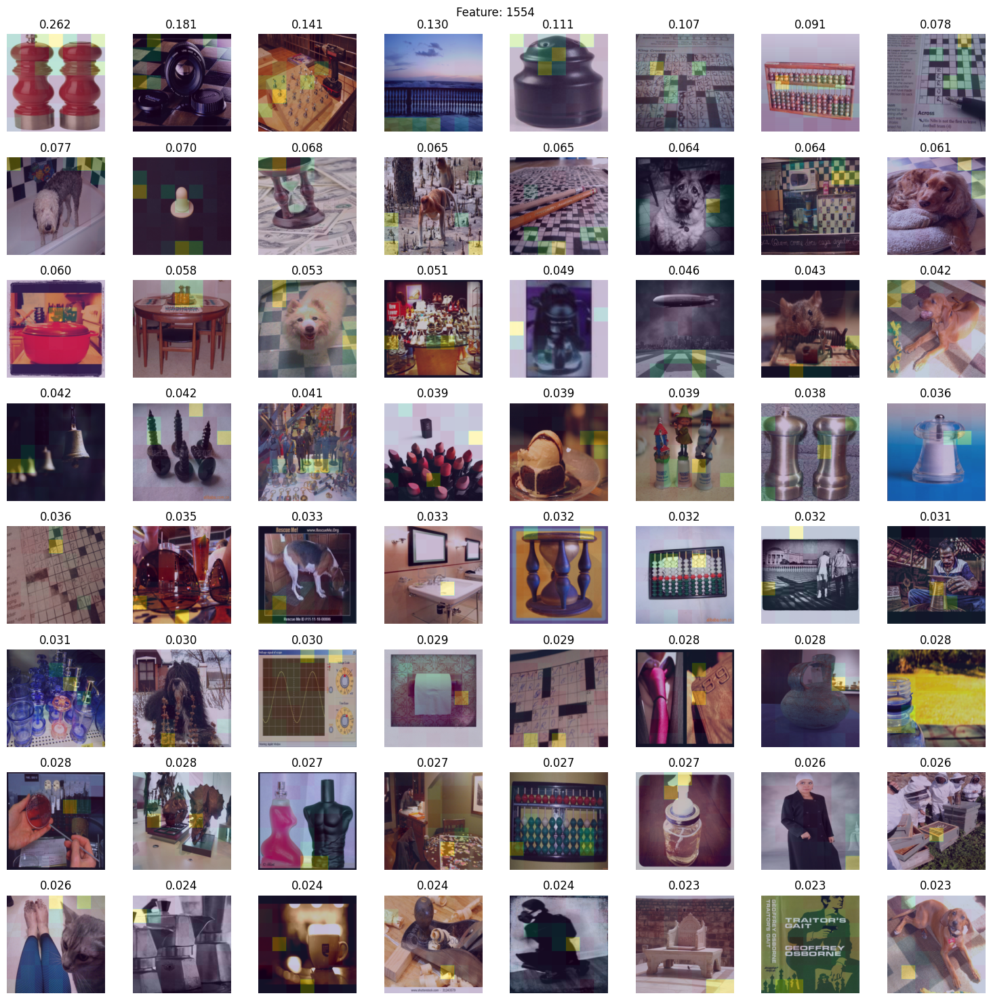

 82%|████████▏ | 9/11 [01:11<00:15,  7.95s/it]

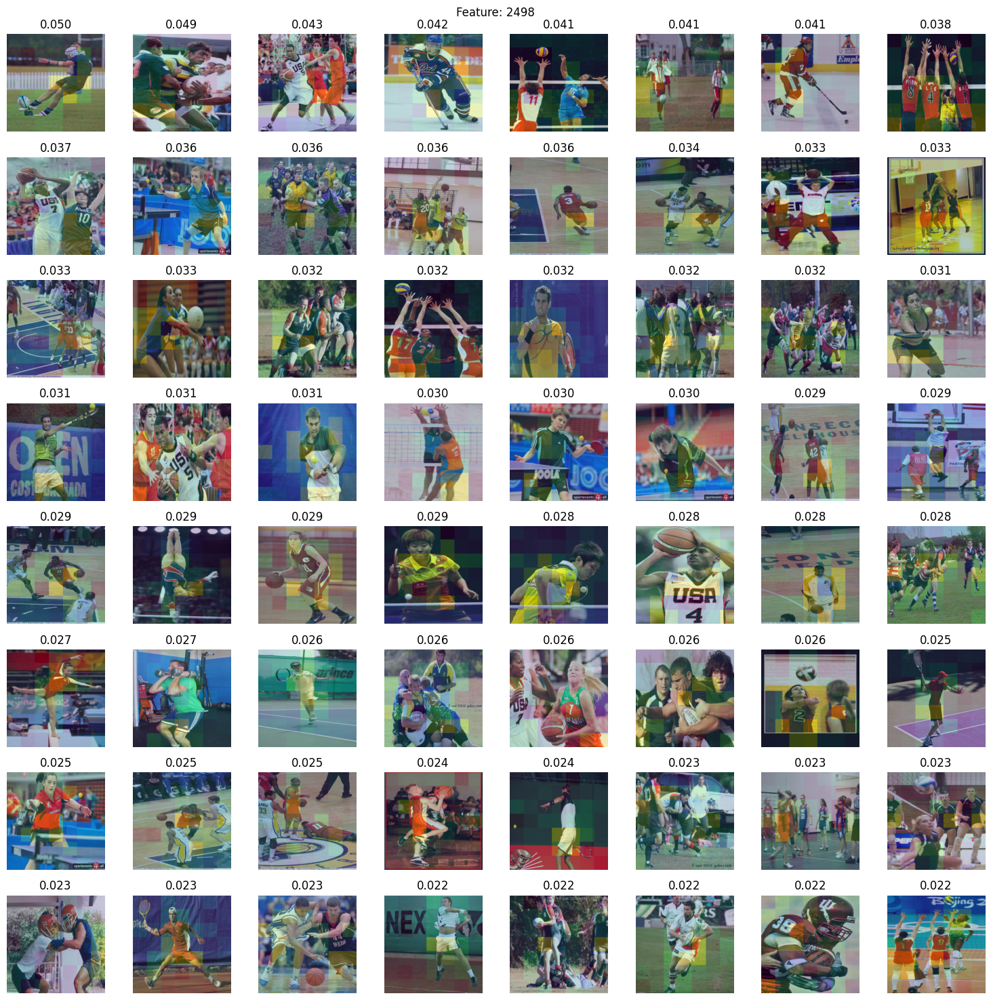

 91%|█████████ | 10/11 [01:20<00:08,  8.13s/it]

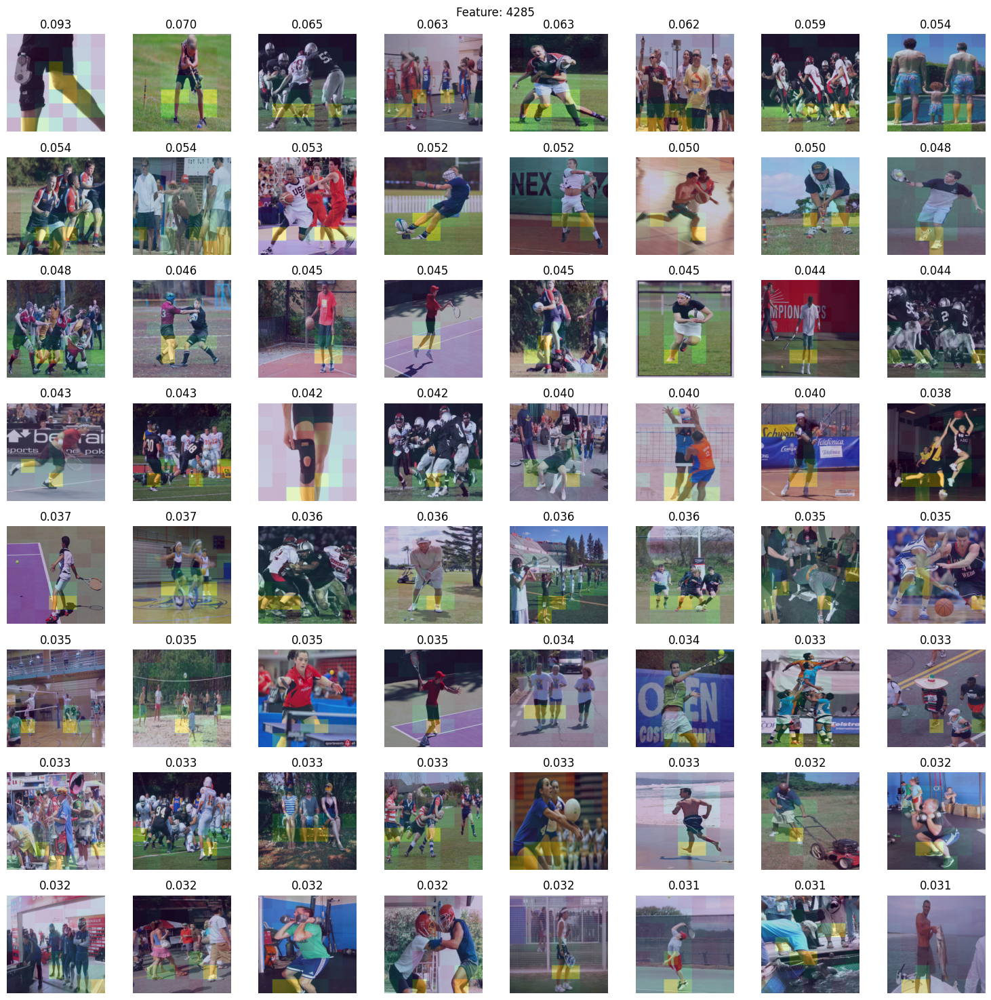

100%|██████████| 11/11 [01:28<00:00,  8.01s/it]


In [8]:
visualize_top_activating_images(model, sae, top_activations_per_feature, dataset, visualize_dataset, device, patch_size=32)

Define the second order code (mostly taken from https://github.com/yossigandelsman/second_order_lens)

In [92]:

class SecondOrderPrsNeurons(object):
    def __init__(
        self,
        model:HookedViT,
        sae,
        sae_hook_point,
        hook_layer,
        device,
        only_these_features =None,
        coefficient: float = 100.
    ):
        self.hook_layer = hook_layer
        self.coefficient = coefficient
        self.model:HookedViT = model
        self.sae = sae
        self.sae_hook_point = sae_hook_point
        self.only_these_features = only_these_features
        self.device = device
        self.reinit()

    def reinit(self):
        # self.mlp_outputs = []
        self.sae_acts = None
        self.ln_1_mean = []
        self.attn_maps = []
        self.ln_1_std = []
        self.post_ln_mean = None
        self.post_ln_std = None
        self.finalized = False

    def log_attention_map(self, ret, hook):
        self.attn_maps.append(ret.detach().cpu().numpy())  # [B, H, N, N]
        return ret
    
    def log_post_ln_mean(self, ret, hook):
        # hook the last transfomer block output 
        self.post_ln_mean = ret.mean(axis=-1, keepdim=True)[:,0].detach().cpu().numpy()
        return ret

    def log_post_ln_std(self, ret, hook):
        self.post_ln_std = ret[:,0].detach().cpu().numpy()  # [b, 1]
        return ret

    def log_ln_1_mean(self, ret, hook):
        self.ln_1_mean.append( ret.mean(axis=-1, keepdim=True).detach().cpu().numpy())
        return ret

    def log_ln_1_std(self, ret, hook):

        std = ret - ret.mean(axis=-1, keepdim=True)  # [batch, pos, length]
        
        std =   (std.pow(2).mean(-1, keepdim=True) + self.model.cfg.eps).sqrt()
        
        self.ln_1_std.append(std.detach().cpu().numpy())
        return ret

    def log_sae_acts(self, ret, hook):

        feature_acts = self.sae.encode_standard(ret)

        if self.only_these_features is not None:
            feature_acts = feature_acts[:,:, self.only_these_features]

        self.sae_acts = feature_acts.detach().cpu().numpy()

        return ret
    
    @torch.no_grad()
    def normalize_before_attention_per_neuron(self, input_tensor, layer_num):
        # Layer num is the output layer. input is [b, tokens, neurons, value]
        normalization_term = (1 + layer_num * 2) * input_tensor.shape[2]
        current_layer_norm = self.model.blocks[layer_num].ln1
  
        mean_centered = input_tensor - self.ln_1_mean[:, layer_num-1-self.hook_layer, :, np.newaxis] / normalization_term
        weighted_mean_centered = (
            current_layer_norm.w.detach().to(self.device) * mean_centered
        )
        weighted_mean_by_std = weighted_mean_centered / self.ln_1_std[:, layer_num-1-self.hook_layer, :, np.newaxis]
        bias_term = (
            current_layer_norm.b.detach().to(self.device) / normalization_term
        )
        # Summing that at axis=2 gives us self.post_ln_1_norm[layer]
        return weighted_mean_by_std + bias_term

    @torch.no_grad()
    def apply_attention_matrix_per_neuron(self, input_tensor, layer_num, head_num):
        # input_tensor is [b, tokens, neurons, value] (x is the tokens)
        neurons = input_tensor.shape[2]
        attn_map = self.attn_maps[:, layer_num-1-self.hook_layer]  # [B, H, N, N]
        attn_layer = self.model.blocks[layer_num].attn
        num_heads = self.model.cfg.n_heads

        head_dim = self.model.cfg.d_head
        # get the current v's and bias

        v_bias = attn_layer.b_V.detach().to(self.device)
        # v_bias.shape is [1, 16, 1, 64]
        v_weight = attn_layer.W_V.detach().to(self.device)
        v = torch.einsum(
            "bnxc,cd->bnxd", input_tensor, v_weight.to(self.device)[head_num]
        ) 
        v = v + v_bias[head_num] / ((1 + layer_num * 2) * neurons) 
        x = torch.einsum("bnm,bmxc->bnxc", attn_map[:, head_num], v)
        ret = torch.einsum(
            "bnxc,dc->bnxd",
            x,
            attn_layer.W_O.detach()
            .to(self.device)
            .reshape(-1, num_heads, head_dim)[
                :, head_num, :
            ],
        )
        ret += attn_layer.b_O.detach().to(self.device)[
            np.newaxis, np.newaxis, np.newaxis, :
        ] / ((1 + layer_num * 2) * num_heads * neurons)
        # ret is bnd. To get the projection to the class token we should do ret[:, 0]
        return ret

    @torch.no_grad()
    def project_attentions_to_output_per_neuron(self, bnmc, layer_in, layer_out):
        # [b, tokens, neurons, values]
        num_blocks = self.model.cfg.n_layers
        num_heads = self.model.cfg.n_heads
        normalization_term = (
            (1 + layer_out * 2) * (1 + num_blocks * 2) * num_heads * bnmc.shape[2]
        )
        # The first element is for how much each element before [out layer] is contributing
        # The second element is for how much out layer contributes to the output
        if layer_in >= layer_out:
            raise ValueError(
                "Wrong order: layer_in ({layer_in}) larger than layer_out ({layer_out})."
            )

  
        mean_centered = (
            bnmc[:, 0]
            - self.post_ln_mean.to(self.device)[:, np.newaxis] / normalization_term
        )  # [b c]

        weighted_mean_centered = (
            self.model.ln_final.w.detach().to(self.device) * mean_centered
        )
        weighted_mean_by_std = weighted_mean_centered / self.post_ln_std[:, np.newaxis]
        bias_term = (
            self.model.ln_final.b.detach().to(self.device) / normalization_term
        )
        post_ln = weighted_mean_by_std + bias_term
        return post_ln @ self.model.head.W_H.detach().to(self.device)  # (b, 1024) #TODO what about the bias? b_H

    # def apply_mlp_post(self, mlps, layer):
    #     # mlps are [b, tokens, neurons]
    #     proj = self.model.visual.transformer.resblocks[layer].mlp.c_proj
    #     per_neuron_proj = torch.einsum('btn,nm->btnm', mlps, proj.weight.T)
    #     per_neuron_proj += proj.bias[np.newaxis, np.newaxis, np.newaxis, :] / mlps.shape[-1]
    #     return per_neuron_proj # [b, tokens, neurons, value]
    # assuming the sae internals are hooked! 
    def apply_sae_post(self, acts):

        if self.only_these_features is not None:
            W_dec = self.sae.W_dec[self.only_these_features]
        else:
            W_dec = self.sae.W_dec
        per_activation_proj = torch.einsum('btn,nm->btnm', acts, W_dec)
        per_activation_proj += self.sae.b_dec[np.newaxis, np.newaxis, np.newaxis, :] / acts.shape[-1]
        return per_activation_proj
    @torch.no_grad()
    def apply_attention_head_and_project_layer_neurons(self, layer, head, final_representation):
        # This includes everything but for one neuron layer, including projection to the output space.
        assert self.finalized
        assert self.hook_layer < layer

        mlp_outputs = self.apply_sae_post(
            self.sae_acts
        ) # [b, tokens, acts, dim]
        normalized = self.normalize_before_attention_per_neuron(
            mlp_outputs, layer
        ) # [b, tokens, acts, dim]
        after_attention = self.apply_attention_matrix_per_neuron(
            normalized, layer, head
        ) # [b, tokens, acts, dim]
        projected = self.project_attentions_to_output_per_neuron(
            after_attention, self.hook_layer, layer
        )
        attentions = projected.detach().cpu().numpy() * self.coefficient
        torch.cuda.empty_cache()
        # return attentions
        return (
            attentions
            / final_representation.norm(dim=-1)
            .detach()
            .cpu()
            .numpy()[:, np.newaxis, np.newaxis]
        )
    
    def finalize(self):
        if self.finalized:
            return
        # Now we can calculate the post-ln scaling, and project it (and normalize by the last norm)
        self.attn_maps = np.stack(self.attn_maps, axis=1)
        self.attn_maps = torch.from_numpy(self.attn_maps).to(self.device)
        self.sae_acts = torch.from_numpy(self.sae_acts).to(self.device)
        self.ln_1_mean = torch.from_numpy(np.stack(self.ln_1_mean, axis=1)).to(
            self.device
        )
        self.ln_1_std = torch.from_numpy(np.stack(self.ln_1_std, axis=1)).to(
            self.device
        )
        self.post_ln_mean = torch.from_numpy(self.post_ln_mean).to(self.device)
        self.post_ln_std = torch.from_numpy(self.post_ln_std).to(self.device)
        self.finalized = True


def hook_prs_logger(
    model,
    hook_layer,
    sae,
    sae_hook_point,
    device,
    coefficient=100,

    only_these_features=None,
):
    """Hooks a projected residual stream logger to the model."""
    prs = SecondOrderPrsNeurons(model, sae, sae_hook_point, hook_layer, device,coefficient=coefficient,only_these_features=only_these_features)

    fwd_hooks = []
    fwd_hooks.append((sae_hook_point, prs.log_sae_acts))

    fwd_hooks.append((f"blocks.{model.cfg.n_layers-1}.hook_resid_post", prs.log_post_ln_mean))
    fwd_hooks.append((f"ln_final.hook_scale", prs.log_post_ln_std))
    for layer in range(hook_layer+1, model.cfg.n_layers):
        assert model.cfg.use_attn_in == False and model.cfg.use_split_qkv_input == False, "need to think about these cases"
        fwd_hooks.append((f"blocks.{layer}.hook_resid_pre", prs.log_ln_1_mean))
        fwd_hooks.append((f"blocks.{layer}.hook_resid_pre", prs.log_ln_1_std))
        fwd_hooks.append((f"blocks.{layer}.attn.hook_pattern", prs.log_attention_map))

    return prs, fwd_hooks



In [93]:

#TODO SPLIT
only_these_features = feature_ids
prs, fwd_hooks = hook_prs_logger(model,hook_layer,sae, hook_point, device, only_these_features=only_these_features )

second_order_effects = {}
for i, feature_id in enumerate(feature_ids):
    max_vals, max_inds = top_activations_per_feature[feature_id]
    images = []
    for bid in max_inds:

        model_image, _, _ = dataset[bid]
        images.append(model_image)

    images = np.stack(images, axis=0)

    images = torch.from_numpy(images).to(device)

    prs.only_these_features = [feature_id]
    prs.reinit()
    representation = model.run_with_hooks(
        images, fwd_hooks=fwd_hooks
    )
    prs.finalize()
    current_res = []
    for layer in range(
        hook_layer + 1, model.cfg.n_layers
    ):
        for head in range(model.cfg.n_heads):
            out = prs.apply_attention_head_and_project_layer_neurons(
                    layer, head, representation
                )
            
            current_res.append(out)
    second_order_effects[feature_id] = np.stack(current_res, axis=0).sum(axis=0)


We got the results, lets try a simple argmax 

In [97]:
dataloader = DataLoader(dataset, batch_size=512, shuffle=True, num_workers=0)
random_batch = next(iter(dataloader))
random_batch = random_batch[0].to(device)

random_output = model(random_batch)
random_output = random_output/random_output.norm(p=2, dim=-1, keepdim=True)

random_output_avg = torch.mean(random_output, dim=0)

def first_principal_component(X):
    X_centered = X - X.mean(dim=0)
    cov_matrix = torch.mm(X_centered.T, X_centered) / (X.size(0) - 1)
    eigenvalues, eigenvectors = torch.linalg.eig(cov_matrix)
    first_component = eigenvectors[:, torch.argsort(eigenvalues.real, descending=True)[0]]
    return first_component.real

for i, feature_id in enumerate(feature_ids):
    print("FEATURE", feature_id, "HUMAN DESCRIPTION", descriptions[i])
    outputs = second_order_effects[feature_id][:,0,:]

    outputs = torch.from_numpy(outputs).to(device)

    print(outputs.shape)


    first= True
    if first:
        #outputs= outputs - random_output_avg

        outputs = first_principal_component(outputs) 
        #outputs= outputs - random_output_avg  
        vals = einsum( "D, T D -> T", outputs, clip_text_stuff.labels_projected)

    else:

        outputs= outputs - random_output_avg
            
        scores = einsum( "I D, T D -> I T", outputs, clip_text_stuff.labels_projected)
        vals = torch.mean(scores, dim=0) 
    # see which ones maximize the direction across all images
    top_k = 10
    top_k_values, top_k_indices = torch.topk(vals, top_k, dim=0)
    
    for j, ind in enumerate(top_k_indices):
        ind = ind.item()
        print(f"{j}. {clip_text_stuff.labels[ind]}")

FEATURE 2381 HUMAN DESCRIPTION mustache
torch.Size([64, 512])
0. Quaint cottage garden
1. peaceful garden pond
2. Snowy forest trail
3. Sublime and serene mountain lake
4. Graceful swimming fish
5. misty forest path
6. Quiet forest stream
7. Serene garden pond 
8. Time-worn artifacts
9. Tranquil mountain retreat 
FEATURE 6405 HUMAN DESCRIPTION bike
torch.Size([64, 512])
0. Aerial view of a desert oasis
1. Aerial view of a construction site
2. Detailed illustration of a futuristic bioreactor
3. Aerial view of an archaeological site
4. Aerial view of an industrial area
5. Detailed illustration of a futuristic medical breakthrough
6. Illustration of a hidden ancient ruin
7. Caricature of an iconic scientist
8. Illustration of a hidden ancient city
9. Aerial view of an agricultural field
FEATURE 5379 HUMAN DESCRIPTION food market (CLS TOKEN!)
torch.Size([64, 512])
0. Quaint cottage garden
1. peaceful garden pond
2. Sublime and serene mountain lake
3. serene mountain retreat
4. Tranquil mou